라이브러리

In [1]:
import pandas as pd
import numpy as np
from keras.utils import *
from sklearn.preprocessing import *
from keras import backend as K
from keras.models import load_model
from keras.layers import LSTM, Dense, concatenate, Input
from sklearn.ensemble import GradientBoostingRegressor
from keras.models import Model
from keras.models import Sequential
import matplotlib.pyplot as plt
from keras.metrics import mean_squared_error
from sklearn.metrics import r2_score
import matplotlib.font_manager as fm
from matplotlib.dates import DateFormatter
from keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau

# 모델명(= 파일명) 설정
tank = 5
model_name = 'Test231113_power_crop720_only-gd'

In [2]:
# r_squared 평가 함수
def r_squared(y_true, y_pred):
    ss_res = K.sum(K.square(y_true - y_pred))
    ss_tot = K.sum(K.square(y_true - K.mean(y_true)))
    return (1 - ss_res/(ss_tot + K.epsilon()))

데이터셋 설정

In [3]:
power = pd.read_csv("E:/kimwoojae/Research/DO Regressor/dataset/powerconsumption.csv")
power['Datetime'] = pd.to_datetime(power['Datetime'], format='%m/%d/%Y %H:%M', errors='raise')
power.describe()
power.set_index('Datetime', inplace=True)

start_date = '2017-01-01'
end_date = '2017-11-30'
power_test = power.loc[start_date:end_date]

start_date = '2017-12-01'
end_date = '2017-12-30'
power_validation= power.loc[start_date:end_date]

power_test_X = power_test[['GeneralDiffuseFlows']]
power_test_y = power_test[['PowerConsumption_Zone1']]

power_validation_X = power_validation[['GeneralDiffuseFlows']]
power_validation_y = power_validation[['PowerConsumption_Zone1']]

In [4]:
power_test_X_chunks = np.asarray(power_test_X, dtype=np.float64)
power_test_X_chunks = power_test_X_chunks.reshape((-1, 144, 1))
power_test_y_chunks = np.asarray(power_test_y, dtype=np.float64)
power_test_y_chunks = power_test_y_chunks.reshape((-1, 144, 1))

power_validation_X_chunks = np.asarray(power_validation_X, dtype=np.float64)
power_validation_X_chunks = power_validation_X_chunks.reshape((-1, 144, 1))
power_validation_y_chunks = np.asarray(power_validation_y, dtype=np.float64)
power_validation_y_chunks = power_validation_y_chunks.reshape((-1, 144, 1))

In [5]:
print(power_test_X_chunks.shape)
print(power_test_y_chunks.shape)
print(power_validation_X_chunks.shape)
print(power_validation_y_chunks.shape)

(334, 144, 1)
(334, 144, 1)
(30, 144, 1)
(30, 144, 1)


LSTM 모델 학습 (학습시에만 사용, 그외에는 불필요)

In [8]:
# LSTM 모델 생성
model = Sequential()
model.add(LSTM(128, input_shape=(144, 1), return_sequences=True))
model.add(LSTM(64, return_sequences=True))
model.add(LSTM(32))
model.add(Dense(144, activation='linear'))
 
model.summary()

# mae와 r_squared 평가함수 추가.
model.compile(optimizer='adam', loss='mse', metrics=['mae', r_squared])


checkpoint = ModelCheckpoint(model_name + '_best.h5', monitor='val_loss', save_best_only=True)
early_stop = EarlyStopping(monitor='val_loss', patience=5, verbose=1)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, verbose=1)

# ModelCheckpoint : 검증 손실이 낮아진 경우에 최적의 모델을 저장
# EarlyStopping : 검증 손실이 일정 기간동안 향상되지 않으면 학습을 조기 종료
# ReduceLROnPlateau : 검증 손실이 개선되지 않으면 학습률을 조정하는 등의 동작 수행.


hist = model.fit(power_test_X_chunks, power_test_y_chunks, epochs = 1000000, batch_size = 256, validation_data=(power_validation_X_chunks, power_validation_y_chunks), callbacks=[checkpoint, early_stop, reduce_lr])
model.save(model_name+'.h5')

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_6 (LSTM)               (None, 144, 128)          66560     
                                                                 
 lstm_7 (LSTM)               (None, 144, 64)           49408     
                                                                 
 lstm_8 (LSTM)               (None, 32)                12416     
                                                                 
 dense_2 (Dense)             (None, 144)               4752      
                                                                 
Total params: 133,136
Trainable params: 133,136
Non-trainable params: 0
_________________________________________________________________
Epoch 1/1000000
2/2 [==============================] - 9s 2s/step - loss: 1116486784.0000 - mae: 32643.2402 - r_squared: -20.9161 - val_loss: 880540544.0000 - val_mae: 29024.1504 -

모델 평가

In [11]:
# 모델 평가 함수
def grapeNEva(model, X_test_shape, y_test, feed, y_test_shape):
    X_pred = model.predict(X_test_shape)
    X_pred = np.asarray(X_pred, dtype=np.float64)
    X_pred = X_pred.reshape((-1))
    print(len(X_pred))

    # 그래프 생성
    plt.figure(figsize=(15, 7))
    plt.plot(y_test.index, y_test, label='sensor do')  # x축에 년월일, y축에 값
    plt.plot(y_test.index, X_pred, color='red', label='prediction do')  # x축에 년월일, y축에 시분
    plt.plot(y_test.index, feed, color='green', marker='o', linestyle='None', label='feed_quantity')  # x축에 년월일, y축에 시분
    plt.xlabel('date')
    plt.ylabel('do')
    plt.title(model_name)
    plt.legend(['sensor do','prediction do','feed_quantity'])
    plt.show()
    
    # 평가 생성
    result = model.evaluate(X_test_shape, y_test_shape)
    print("MSE // MAE // R-squared ", result)

In [12]:
# r_squared가 따로 만들어서 추가해준 함수기 때문에 불러올 때도 추가해서 불러야한다.
model = load_model(model_name+'.h5', custom_objects={'r_squared': r_squared})

[[-3.41002718e-02  7.87867159e-02  6.86895028e-02  6.33969605e-02
  -1.95567356e-03  7.30388686e-02 -8.96219630e-03  1.12970434e-02
  -7.57982135e-02 -3.93956006e-02  6.13400117e-02 -2.09964011e-02
  -9.41933170e-02  1.01223297e-01  8.60599335e-03 -1.86122712e-02
   4.66229831e-05 -7.48058483e-02 -6.09391853e-02 -1.04292013e-01
   3.56346071e-02 -2.87605617e-02  3.04453559e-02 -6.03786744e-02
  -9.24952477e-02 -2.45822202e-02  8.36875290e-03 -8.95599276e-02
   1.07611511e-02  5.34862913e-02 -5.28789498e-02 -8.21516141e-02
  -7.33885914e-02  1.05996057e-01 -1.07705496e-01 -3.67655940e-02
  -5.78218978e-03 -8.20815340e-02 -8.13516602e-02 -8.64793360e-02
   2.45410185e-02  4.59171087e-02  5.50722517e-02  1.22059723e-02
  -1.27844233e-02 -4.76582199e-02  5.96200190e-02 -4.95603075e-03
   1.03853047e-01 -8.28901604e-02  9.35716331e-02  2.03734785e-02
  -2.51528304e-02  9.73171275e-03  2.37369221e-02  7.31145665e-02
   8.92620385e-02  8.60868320e-02 -7.38272667e-02  8.58692359e-03
   7.86734

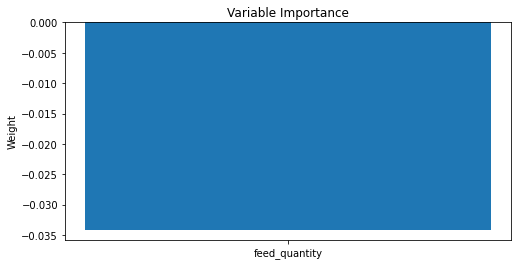

In [13]:
# 가중치를 통해 변수 중요도 획득
weights = model.layers[0].get_weights()[0]
print(weights)


# 변수 중요도 시각화
fig, ax = plt.subplots(figsize=(8, 4))
ax.bar(range(1), weights[:, 0])
ax.set_xticks(range(1))
ax.set_xticklabels(['feed_quantity'])
ax.set_ylabel('Weight')
ax.set_title('Variable Importance')
plt.show()

In [14]:
japonica_validation_features_X

,feed_quantity
mea_dt,
2021-07-21 00:00:00,0.0
2021-07-21 00:01:00,0.0
2021-07-21 00:02:00,0.0
2021-07-21 00:03:00,0.0
2021-07-21 00:04:00,0.0
...,...
2021-09-08 23:55:00,0.0
2021-09-08 23:56:00,0.0
2021-09-08 23:57:00,0.0


In [15]:
X = japonica_validation_data.loc['2021-07-21 00:00':'2021-09-08 23:59']
X_test = X[['feed_quantity']]

X_test_reshape = np.asarray(X_test, dtype=np.float64)
X_test_reshape = X_test_reshape.reshape((-1, 720, 1))

# shape확인
nCar = X_test_reshape.shape[0] # 데이터 개수
nVar = X_test_reshape.shape[2] # 변수 개수
print('nCar: %d' % nCar, 'nVar: %d' % nVar )

nCar: 90 nVar: 1


In [16]:
y_test = X[['do_mg']]


y_test_reshape = np.asarray(y_test, dtype=np.float64)
y_test_reshape = y_test_reshape.reshape((-1, 720, 1))

nCar = y_test.shape[0] # 데이터 개수
nVar = y_test.shape[1] # 변수 개수
print('nCar: %d' % nCar, 'nVar: %d' % nVar )

nCar = y_test_reshape.shape[0] # 데이터 개수
nVar = y_test_reshape.shape[1] # 변수 개수
print('nCar: %d' % nCar, 'nVar: %d' % nVar )

nCar: 64800 nVar: 1
nCar: 90 nVar: 720


64800


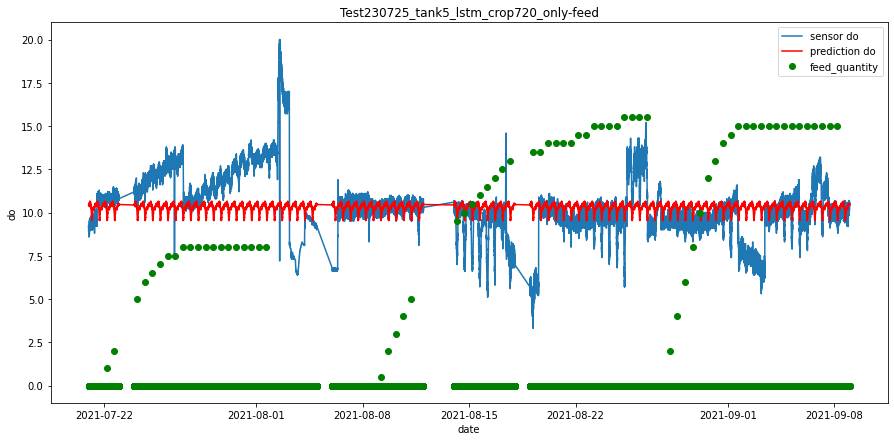

3/3 [==============================] - 1s 30ms/step - loss: 3.5069 - mae: 1.3275 - r_squared: -0.2181
MSE // MAE // R-squared  [3.5069007873535156, 1.3274868726730347, -0.2181416004896164]


In [17]:
grapeNEva(model, X_test_reshape, y_test, X_test[['feed_quantity']], y_test_reshape)

In [18]:
X = japonica_validation_data.loc['2021-08-02 00:00':'2021-08-03 23:59']
X_test = X[['feed_quantity']]

X_test_reshape = np.asarray(X_test, dtype=np.float64)
X_test_reshape = X_test_reshape.reshape((-1, 720, 1))

# shape확인
nCar = X_test_reshape.shape[0] # 데이터 개수
nVar = X_test_reshape.shape[2] # 변수 개수
print('nCar: %d' % nCar, 'nVar: %d' % nVar )

nCar: 4 nVar: 1


In [19]:
y_test = X[['do_mg']]


y_test_reshape = np.asarray(y_test, dtype=np.float64)
y_test_reshape = y_test_reshape.reshape((-1, 720, 1))

nCar = y_test.shape[0] # 데이터 개수
nVar = y_test.shape[1] # 변수 개수
print('nCar: %d' % nCar, 'nVar: %d' % nVar )

nCar = y_test_reshape.shape[0] # 데이터 개수
nVar = y_test_reshape.shape[1] # 변수 개수
print('nCar: %d' % nCar, 'nVar: %d' % nVar )

nCar: 2880 nVar: 1
nCar: 4 nVar: 720


2880


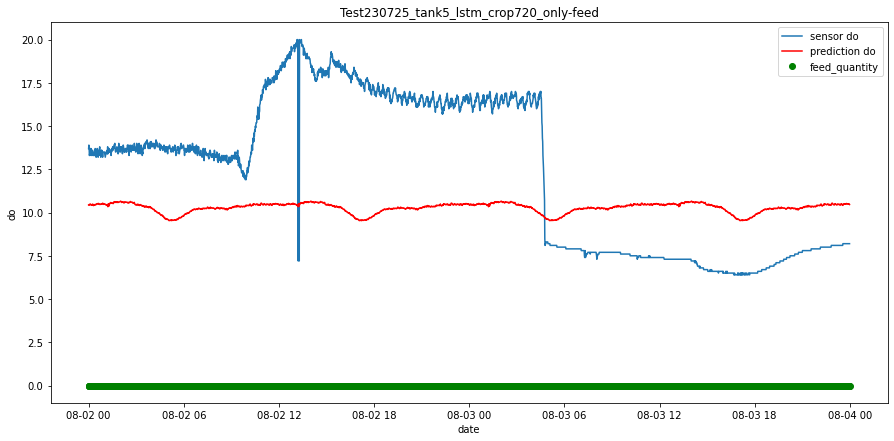

1/1 [==============================] - 0s 61ms/step - loss: 23.8662 - mae: 4.4421 - r_squared: -0.2249
MSE // MAE // R-squared  [23.866241455078125, 4.442098140716553, -0.22491860389709473]


In [20]:
grapeNEva(model, X_test_reshape, y_test, X_test[['feed_quantity']], y_test_reshape)

In [21]:
X = japonica_validation_data.loc['2021-08-01 00:00':'2021-08-08 23:59']
X_test = X[['feed_quantity']]

X_test_reshape = np.asarray(X_test, dtype=np.float64)
X_test_reshape = X_test_reshape.reshape((-1, 720, 1))

# shape확인
nCar = X_test_reshape.shape[0] # 데이터 개수
nVar = X_test_reshape.shape[2] # 변수 개수
print('nCar: %d' % nCar, 'nVar: %d' % nVar )

nCar: 14 nVar: 1


In [22]:
y_test = X[['do_mg']]


y_test_reshape = np.asarray(y_test, dtype=np.float64)
y_test_reshape = y_test_reshape.reshape((-1, 720, 1))

nCar = y_test.shape[0] # 데이터 개수
nVar = y_test.shape[1] # 변수 개수
print('nCar: %d' % nCar, 'nVar: %d' % nVar )

nCar = y_test_reshape.shape[0] # 데이터 개수
nVar = y_test_reshape.shape[1] # 변수 개수
print('nCar: %d' % nCar, 'nVar: %d' % nVar )

nCar: 10080 nVar: 1
nCar: 14 nVar: 720


10080


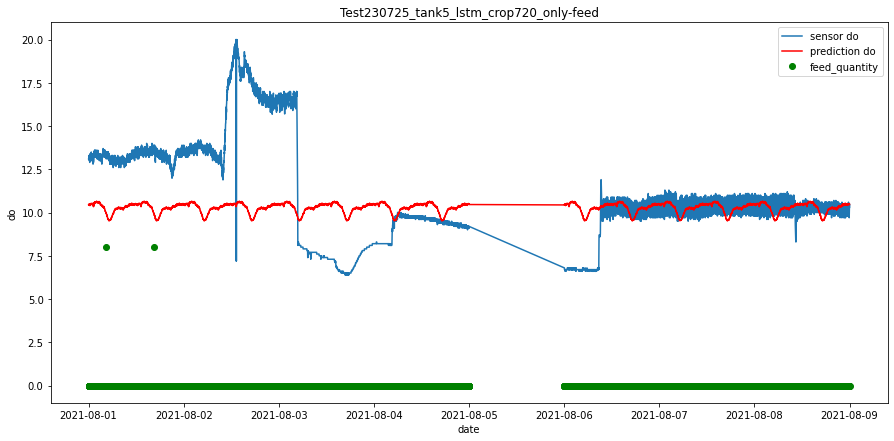

1/1 [==============================] - 0s 70ms/step - loss: 9.0595 - mae: 2.1695 - r_squared: -0.0574
MSE // MAE // R-squared  [9.059487342834473, 2.169480085372925, -0.05736196041107178]


In [23]:
grapeNEva(model, X_test_reshape, y_test, X_test[['feed_quantity']], y_test_reshape)

In [24]:
X = japonica_validation_data.loc['2021-08-03 00:00':'2021-08-03 11:59']
X_test = X[['feed_quantity']]

X_test_reshape = np.asarray(X_test, dtype=np.float64)
X_test_reshape = X_test_reshape.reshape((-1, 720, 1))

# shape확인
nCar = X_test_reshape.shape[0] # 데이터 개수
nVar = X_test_reshape.shape[2] # 변수 개수
print('nCar: %d' % nCar, 'nVar: %d' % nVar )

nCar: 1 nVar: 1


In [25]:
y_test = X[['do_mg']]


y_test_reshape = np.asarray(y_test, dtype=np.float64)
y_test_reshape = y_test_reshape.reshape((-1, 720, 1))

nCar = y_test.shape[0] # 데이터 개수
nVar = y_test.shape[1] # 변수 개수
print('nCar: %d' % nCar, 'nVar: %d' % nVar )

nCar = y_test_reshape.shape[0] # 데이터 개수
nVar = y_test_reshape.shape[1] # 변수 개수
print('nCar: %d' % nCar, 'nVar: %d' % nVar )

nCar: 720 nVar: 1
nCar: 1 nVar: 720


720


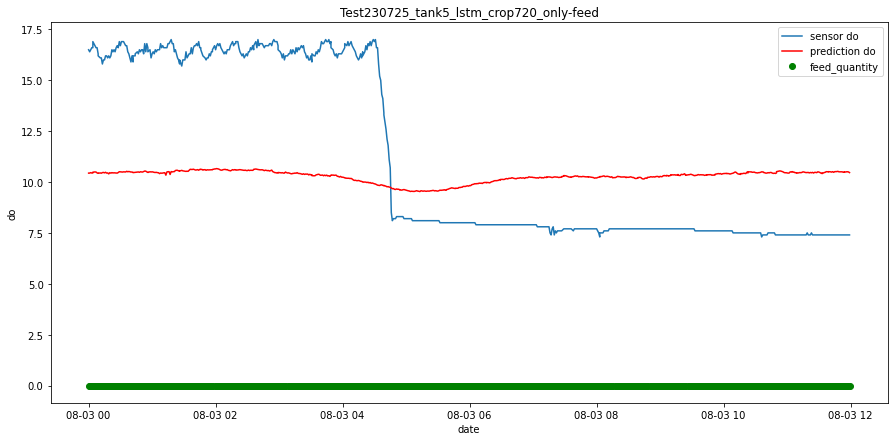

1/1 [==============================] - 0s 70ms/step - loss: 18.0610 - mae: 3.8508 - r_squared: 0.0035
MSE // MAE // R-squared  [18.06104278564453, 3.8507680892944336, 0.0034900903701782227]


In [26]:
grapeNEva(model, X_test_reshape, y_test, X_test[['feed_quantity']], y_test_reshape)

nCar: 1 nVar: 1
nCar: 720 nVar: 1
nCar: 1 nVar: 720
720


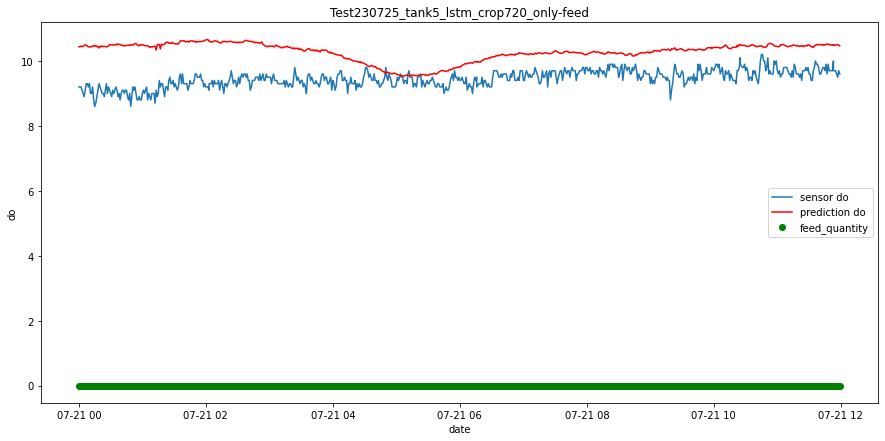

1/1 [==============================] - 0s 66ms/step - loss: 0.8283 - mae: 0.8277 - r_squared: -11.4306
MSE // MAE // R-squared  [0.8283267617225647, 0.8276607990264893, -11.430597305297852]


In [27]:
X = japonica_validation_data.loc['2021-07-21 00:00':'2021-07-21 11:59']
X_test = X[['feed_quantity']]

X_test_reshape = np.asarray(X_test, dtype=np.float64)
X_test_reshape = X_test_reshape.reshape((-1, 720, 1))

# shape확인
nCar = X_test_reshape.shape[0] # 데이터 개수
nVar = X_test_reshape.shape[2] # 변수 개수
print('nCar: %d' % nCar, 'nVar: %d' % nVar )

y_test = X[['do_mg']]


y_test_reshape = np.asarray(y_test, dtype=np.float64)
y_test_reshape = y_test_reshape.reshape((-1, 720, 1))

nCar = y_test.shape[0] # 데이터 개수
nVar = y_test.shape[1] # 변수 개수
print('nCar: %d' % nCar, 'nVar: %d' % nVar )

nCar = y_test_reshape.shape[0] # 데이터 개수
nVar = y_test_reshape.shape[1] # 변수 개수
print('nCar: %d' % nCar, 'nVar: %d' % nVar )

grapeNEva(model, X_test_reshape, y_test, X_test[['feed_quantity']], y_test_reshape)